<a href="https://colab.research.google.com/github/keziah65/dsi30-projects/blob/main/Capstone%20Project/code/02-modelling.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

[![Open In Colab](https://colab.research.google.com/assets/colab-badge.svg)](https://colab.research.google.com/github/siowcm/capstone/blob/main/code/02-modelling.ipynb)

# Capstone Project: Mask Up

Note: Code ran in Google Colab

---

## Table of Contents

1. Clone Githubs
2. Import Libraries
3. Preprocessing
4. YOLOv5 model
5. Evaluate model's performance
6. Generate Score for Test Dataset
7. Visualizing ConvNet Layers
8. Visualizing Inference
9. Save Trained Weights
---

## Clone Githubs

In [ ]:
# clone github repo
!git clone https://github.com/siowcm/capstone.git
!git clone https://github.com/ultralytics/yolov5

Cloning into 'capstone'...
remote: Enumerating objects: 7640, done.
remote: Counting objects: 100% (1850/1850), done.
remote: Compressing objects: 100% (940/940), done.
remote: Total 7640 (delta 915), reused 1840 (delta 905), pack-reused 5790
Receiving objects: 100% (7640/7640), 446.93 MiB | 22.79 MiB/s, done.
Resolving deltas: 100% (1763/1763), done.
Checking out files: 100% (7495/7495), done.
Cloning into 'yolov5'...
remote: Enumerating objects: 11142, done.
remote: Total 11142 (delta 0), reused 0 (delta 0), pack-reused 11142
Receiving objects: 100% (11142/11142), 11.09 MiB | 20.25 MiB/s, done.
Resolving deltas: 100% (7708/7708), done.


In [ ]:
# check GPU
!nvidia-smi

Mon Feb 28 15:36:01 2022       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 460.32.03    Driver Version: 460.32.03    CUDA Version: 11.2     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla P100-PCIE...  Off  | 00000000:00:04.0 Off |                    0 |
| N/A   33C    P0    27W / 250W |      0MiB / 16280MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

In [ ]:
# install yolo dependencies and API
%cd yolov5
%pip install -qr requirements.txt
%pip install -q roboflow
%pip install -q wandb

/content/yolov5
     |████████████████████████████████| 596 kB 10.1 MB/s 
     |████████████████████████████████| 1.1 MB 13.4 MB/s 
     |████████████████████████████████| 178 kB 67.2 MB/s 
     |████████████████████████████████| 138 kB 73.6 MB/s 
     |████████████████████████████████| 145 kB 79.3 MB/s 
     |████████████████████████████████| 67 kB 6.5 MB/s 
     |████████████████████████████████| 63 kB 2.1 MB/s 
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
google-colab 1.0.0 requires requests~=2.23.0, but you have requests 2.27.1 which is incompatible.
datascience 0.10.6 requires folium==0.2.1, but you have folium 0.8.3 which is incompatible.
albumentations 0.1.12 requires imgaug<0.2.7,>=0.2.5, but you have imgaug 0.2.9 which is incompatible.
     |████████████████████████████████| 1.7 MB 7.4 MB/s 
     |████████████████████████████████| 181 kB 68.4 MB/s 


## Import Libraries

In [ ]:
# import libraries
import torch
import os, glob, re
import cv2
import pandas as pd
import matplotlib.pyplot as plt
from roboflow import Roboflow
import wandb

In [ ]:
# set up environment
os.environ["DATASET_DIRECTORY"] = "/content/datasets"

## Preprocessing

For preprocessing, I have used [Roboflow](https://roboflow.com/) API to do the follwing preprocessing steps:  

#### Train, validation, test split
- 70%, 20%, 10% split (593, 170, 85 images respectively)
- As there is a class imbalance in the image dataset, the dataset need to be split the in stratified manner. 
- Fortunately, roboflow does the split quite effortlessly ensuring that each class is represented in the correct proportion.

#### Image resizing
- Input images to yolo has to be in square aspect ratio, thus resized into a square image e.g. 320 by 320 or 640 by 640. 
- In order to maintain the aspect ratio after resizing, padding is required. I have selected black pixels as padded for this project. 

#### image augmentation
- Image augmentation help to increase the size to the training set and provides a less than ideal condition of how each class would look like (mask, no_mask, incorrect). In this project, I have selected 3 types of augmentation. (1) horizontal flip, (2) +-10° rotation, and (3) applied mosaic*.
- After image augmentation is applied, the number of training images increased from 593 to 1,779. 
- The validation and testing dataset remained at 170 and 85 respectively. As they served as the ground truth, it should not be augmented. 

*Note: Mosaic works by taking four source images and combining them together into one. Allows for the model to learn how to identify objects at a smaller scale than normal.

======= sample mosaic training image =======

![image_augmentation.jpg](https://github.com/siowcm/capstone/blob/main/assets/image_augmentation.jpg?raw=1)

In [ ]:
# Get the dataset from robot through their API
rf = Roboflow(api_key="ENTER-YOUR-API-KEY") #API key masked off
project = rf.workspace("cheemingsiow01-gmail-com").project("facemask-iyplj")
dataset = project.version(3).download("yolov5")

loading Roboflow workspace...
loading Roboflow project...


Extracting Dataset Version Zip to /content/datasets/facemask-3 in yolov5pytorch:: 100%|██████████| 4080/4080 [00:05<00:00, 766.98it/s] 


## YOLOv5 model

In order to built a object detection model, I have selected state of the art Yolov5. Yolov5 is a single stage object detector. This means that there is a fast inference time giving that the region proposal and classification is done in in step. The [architecture](https://github.com/ultralytics/yolov5/issues/1333) has 23 layers ([0-9] head layers & [10-23] head layers)




```python
YOLOv5 v6.0 backbonebackbone:
  \# [from, number, module, args]
  [[-1, 1, Conv, [64, 6, 2, 2]],  # 0-P1/2
   [-1, 1, Conv, [128, 3, 2]],  # 1-P2/4
   [-1, 3, C3, [128]],
   [-1, 1, Conv, [256, 3, 2]],  # 3-P3/8
   [-1, 6, C3, [256]],
   [-1, 1, Conv, [512, 3, 2]],  # 5-P4/16
   [-1, 9, C3, [512]],
   [-1, 1, Conv, [1024, 3, 2]],  # 7-P5/32
   [-1, 3, C3, [1024]],
   [-1, 1, SPPF, [1024, 5]],  # 9
  ]

YOLOv5 v6.0 head:
  [[-1, 1, Conv, [512, 1, 1]],
   [-1, 1, nn.Upsample, [None, 2, 'nearest']],
   [[-1, 6], 1, Concat, [1]],  # cat backbone P4
   [-1, 3, C3, [512, False]],  # 13

   [-1, 1, Conv, [256, 1, 1]],
   [-1, 1, nn.Upsample, [None, 2, 'nearest']],
   [[-1, 4], 1, Concat, [1]],  # cat backbone P3
   [-1, 3, C3, [256, False]],  # 17 (P3/8-small)

   [-1, 1, Conv, [256, 3, 2]],
   [[-1, 14], 1, Concat, [1]],  # cat head P4
   [-1, 3, C3, [512, False]],  # 20 (P4/16-medium)

   [-1, 1, Conv, [512, 3, 2]],
   [[-1, 10], 1, Concat, [1]],  # cat head P5
   [-1, 3, C3, [1024, False]],  # 23 (P5/32-large)

   [[17, 20, 23], 1, Detect, [nc, anchors]],  # Detect(P3, P4, P5)
  ]
```

As I envision the object detector to have real time inference capability and to be deployed on IoT devices, I have selected *yolov5s* pre-trained weights. The "*yolov5s*" model provides a good inference time and low computation requirement. However, it is also good to appreciate that pre-trained weights such as "yolov5x" has a higher mAP score but comes in a higher computing cost and inference speed.

For the training, I will be using [Weights & Biases API](#https://wandb.ai/site) to track the training process. Weights & Biases provides experiment tracking and visualization tool.

For yolov5s, I have ran the model a few times with the following variations:
1. input image size 320, with no augmentations
2. input image size 320, with augmentations
3. input image size 640, with no augmentations
4. input image size 640, with augmentations

Note that in this notebook only show one of the run. 

In [ ]:
# run weights and biases API(optional)
!wandb login

wandb: You can find your API key in your browser here: https://wandb.ai/authorize
wandb: Paste an API key from your profile and hit enter, or press ctrl+c to quit: 
wandb: Appending key for api.wandb.ai to your netrc file: /root/.netrc


Yolov5 provide a script for object detection training. Some of the parameters are:
- img > image size 
- batch > batch size refers to number of images loaded for 1 iteration
- epochs > number of training epochs
- patience > default patience is 100 e.g. if there is no improvement in fitness* for next 100 epochs, the training will be terminated.
- weights > pretrain weights
- cache > cache images for faster training


*Note that for yolov5 implementation of patience, it is based on model's 'fitness'. The fitness is defined as 0.1 mAP@.5 and 0.9 mAP@.5:.95. 


In [ ]:
# parameters
image_size = 640
batch = 32
epochs = 1000
patience = 100
cache = "ram"
data_yaml = dataset.location + "/data.yaml"
pre_train_weights = "yolov5s.pt"

In [ ]:
#run training scrip
!python train.py \
    --imgsz {image_size} \
    --batch {batch} \
    --epochs {epochs} \
    --data {data_yaml} \
    --weights {pre_train_weights} \
    --cache {cache} \

wandb: Currently logged in as: siowcm (use `wandb login --relogin` to force relogin)
train: weights=yolov5s.pt, cfg=, data=/content/datasets/facemask-3/data.yaml, hyp=data/hyps/hyp.scratch-low.yaml, epochs=1000, batch_size=32, imgsz=640, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, evolve=None, bucket=, cache=ram, image_weights=False, device=, multi_scale=False, single_cls=False, optimizer=SGD, sync_bn=False, workers=8, project=runs/train, name=exp, exist_ok=False, quad=False, cos_lr=False, label_smoothing=0.0, patience=100, freeze=[0], save_period=-1, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest
github: up to date with https://github.com/ultralytics/yolov5 ✅
YOLOv5 🚀 v6.1-11-g63ddb6f torch 1.10.0+cu111 CUDA:0 (Tesla P100-PCIE-16GB, 16281MiB)

hyperparameters: lr0=0.01, lrf=0.01, momentum=0.937, weight_decay=0.0005, warmup_epochs=3.0, warmup_momentum=0.8, warmup_bias_lr=0.1, box=0.05, cls=0.5, cls_pw=1.0, obj=1.0,

## Evaluate Model's Performance

### Metric

For object detection, I have chosen mAP@.5:.95 as the evaluation metric as this is commonly used in research papers and [COCO object detection challenge](https://cocodataset.org/#detection-eval). In short, it uses 10 IoU thresholds of .50:.05:.95. to compute the mAP score. The charts below are extracted from weights and biases. An alternative would be running TensorBoard


### Metric chart

In the metric chart below, it showed the progress of the mAP score for each epoch step. In the usual fashion, the mAP score increase rapidly before plateauing. Based on the mAP evaluation metric, it can be appreciated that allowing bigger input image size (e.g. 640x640 compared to 320 by 320) and applying image augmentation improve the system by a significant margin. The final scores from the best weights are tabulated in the table below. 


|        Models        | mAP_0.5 | mAP_0.5:0.95 |
|:--------------------:|:-------:|:------------:|
| yolov5_640_w/augemnt |   0.96  |     0.75     |
| yolov5_320_w/augemnt |   0.94  |     0.70     |
|      yolov5_640      |   0.81  |     0.53     |
|      yolov5_320      |   0.75  |     0.44     |

![mAP_scores.png](https://github.com/siowcm/capstone/blob/main/assets/mAP_scores.png?raw=1)


### Training & validation loss chart

Yolov5 uses 3 loss component: (1) box, (2) class, and (3) objectness. 

1. Box loss - relate to the size of predicted bounding box with the ground truth bounding box
2. Class loss - relate to the classification prediction
3. Objectness loss - determines whether an object exists at an anchor.

[YOLOv3](https://arxiv.org/abs/1804.02767) paper provided more elaboration.

Losses on test and validation dataset are plotted below. Models with larger image input size and image augmentation generally performed better compared other models. The final loss from the best weights are tabulated in the table below. 

|        Models        | train/box_loss | train/cls_loss | train/obj_loss | val/box_loss | val/cls_loss | val/obj_loss |
|:--------------------:|:--------------:|:--------------:|:--------------:|:------------:|:------------:|:------------:|
| yolov5_640_w/augemnt |      0.015     |     0.00065    |      0.026     |     0.020    |    0.0024    |     0.013    |
| yolov5_320_w/augemnt |      0.017     |     0.00073    |      0.019     |     0.020    |    0.0014    |    0.0083    |
|      yolov5_640      |      0.019     |     0.00079    |     0.0070     |     0.030    |    0.0070    |     0.023    |
|      yolov5_320      |      0.026     |     0.0015     |      0.013     |     0.031    |    0.0065    |     0.012    |




![train_loss.png](https://github.com/siowcm/capstone/blob/main/assets/train_loss.png?raw=1)

---

![val_loss.png](https://github.com/siowcm/capstone/blob/main/assets/val_loss.png?raw=1)


In [ ]:
# logs save in the folder "runs" (use this or weights and biases)
# uncomment this cell block if required
# %load_ext tensorboard
# %tensorboard --logdir runs

## Generate Score for Test Dataset

Trained weights is evaluated against the unseen test dataset. Unsurprisingly, the performance matched the validation result. 

|        Models        |   Dataset  | mAP@.5  | mAP@.5:.95 |
|:--------------------:|:----------:|:-------:|:----------:|
| yolov5_640_w/augemnt | validation |   0.96  |    0.752   |
| yolov5_640_w/augemnt |    Test    |  0.977  |    0.781   |

In [ ]:
# paramters
trained_weights = "runs/train/exp/weights/best.pt"
task = "test"

In [ ]:
# modify the yaml file to enter the test dataset directory
with open(dataset.location + "/data.yaml", "a") as a_file:
    a_file.write("\n")
    a_file.write(f"test: {dataset.location}/test/images")

In [ ]:
#generate score on test dataset 
!python val.py \
    --weights {trained_weights} \
    --data {data_yaml} \
    --imgsz {image_size} \
    --task {task} #specify that evaluation done on test dataset

val: data=/content/datasets/facemask-3/data.yaml, weights=['runs/train/exp/weights/best.pt'], batch_size=32, imgsz=640, conf_thres=0.001, iou_thres=0.6, task=test, device=, workers=8, single_cls=False, augment=False, verbose=False, save_txt=False, save_hybrid=False, save_conf=False, save_json=False, project=runs/val, name=exp, exist_ok=False, half=False, dnn=False
YOLOv5 🚀 v6.1-11-g63ddb6f torch 1.10.0+cu111 CUDA:0 (Tesla P100-PCIE-16GB, 16281MiB)

Fusing layers... 
Model Summary: 213 layers, 7018216 parameters, 0 gradients, 15.8 GFLOPs
test: Scanning '/content/datasets/facemask-3/test/labels' images and labels...85 found, 0 missing, 0 empty, 0 corrupt: 100% 85/85 [00:00<00:00, 811.33it/s]
test: New cache created: /content/datasets/facemask-3/test/labels.cache
               Class     Images     Labels          P          R     mAP@.5 mAP@.5:.95: 100% 3/3 [00:02<00:00,  1.01it/s]
                 all         85        301      0.994      0.958      0.979      0.796
           incorrect

## Inference

In this section, I will use the trained weights to run inference on test images

In [ ]:
# parameter
conf_thres = 0.5
source = dataset.location + "/test/images"
line_thickness = 1

In [ ]:
#run inference on test images
!python detect.py \
    --weights {trained_weights}  \
    --imgsz {image_size} \
    --conf-thres {conf_thres} \
    --source {source} \
    --line-thickness {line_thickness} \
    #--visualize #to save convolution layers, uncomment this if needed (opional)

detect: weights=['runs/train/exp/weights/best.pt'], source=/content/datasets/facemask-3/test/images, data=data/coco128.yaml, imgsz=[640, 640], conf_thres=0.5, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=1, hide_labels=False, hide_conf=False, half=False, dnn=False
YOLOv5 🚀 v6.1-11-g63ddb6f torch 1.10.0+cu111 CUDA:0 (Tesla P100-PCIE-16GB, 16281MiB)

Fusing layers... 
Model Summary: 213 layers, 7018216 parameters, 0 gradients, 15.8 GFLOPs
image 1/85 /content/datasets/facemask-3/test/images/maksssksksss102_jpg.rf.ce4ade0c26546d7b33c7d1d67d6c3d06.jpg: 640x640 1 mask, Done. (0.006s)
image 2/85 /content/datasets/facemask-3/test/images/maksssksksss108_jpg.rf.141adc5b4cb38e6872fc75a896321868.jpg: 640x640 4 masks, 1 no_mask, Done. (0.006s)
image 3/85 /content/datasets/facemask-3/tes

### Visualizing Feature maps

I have included feature maps of 3 stages (0, 9, 23). It can be appreciated that as the images goes to deeper layer, it becomes more abstract.

layer:0
![stage0_Conv_features.png](https://github.com/siowcm/capstone/blob/main/assets/stage0_Conv_features.png?raw=1)

---
layer:9
![stage9_SPPF_features.png](https://github.com/siowcm/capstone/blob/main/assets/stage9_SPPF_features.png?raw=1)

---
layer: 23
![stage23_C3_features.png](https://github.com/siowcm/capstone/blob/main/assets/stage23_C3_features.png?raw=1)

### Visualizing Inference

In [ ]:
# prepare df for with bboxes information for ploting

path = dataset.location + "/test/labels" 
all_files = glob.glob(path + "/*.txt")

#create a empty dataframe
df = pd.DataFrame(columns=["filename", "class", "x", "y", "w", "h"])

#store all the label information in dataframe
for filename in all_files:
    temp = pd.read_csv(
        filename,
        index_col=None,
        delim_whitespace=True,
        names=["class", "x", "y", "w", "h"],
    )
    temp["filename"] = re.search(
        "maksssksksss.+", filename.replace("txt", "jpg")
    ).group()
    df = pd.concat([df, temp], axis=0)
df = df.reset_index(drop=True)

#note that the bbox information in labels/*.txt are stored as x,y,w,h
#need to convert to x1, y1 (top left) and x2, y2 (bottom right)
df["x1"] = image_size * (df["x"] - df["w"] / 2)
df["y1"] = image_size * (df["y"] - df["h"] / 2)
df["x2"] = image_size * (df["x"] + df["w"] / 2)
df["y2"] = image_size * (df["y"] + df["h"] / 2)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:13: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  del sys.path[0]


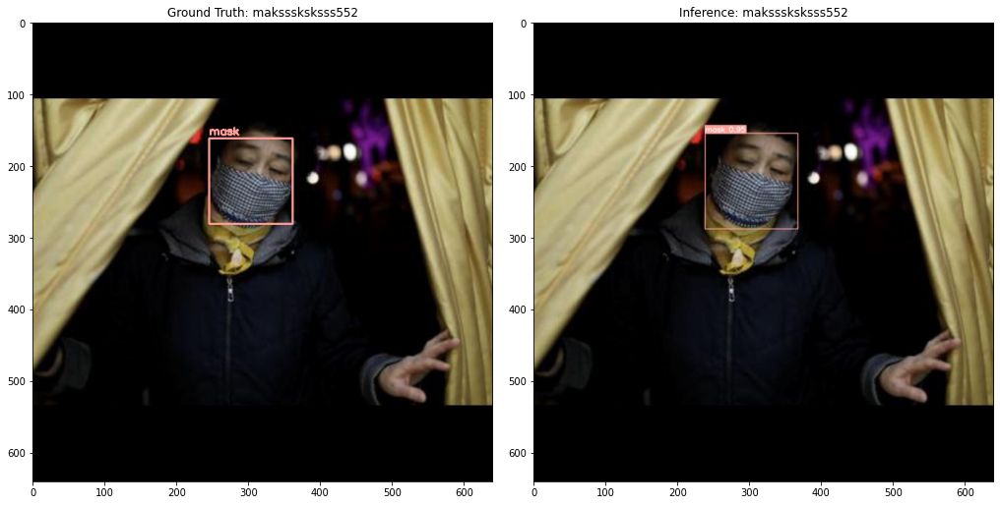

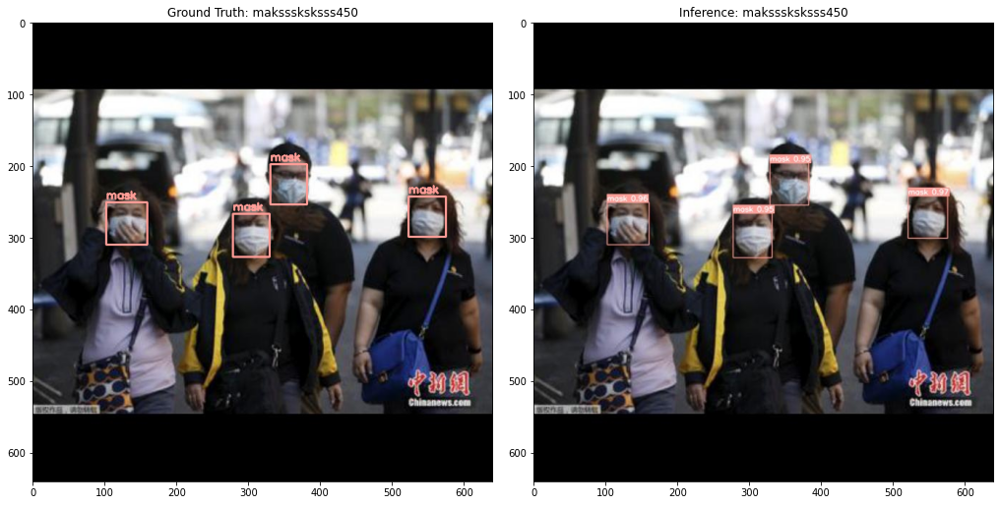

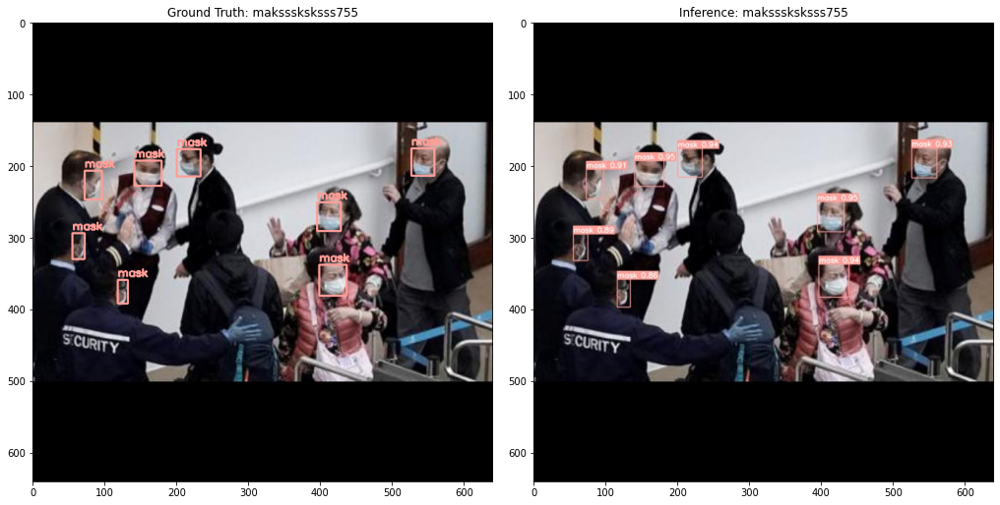

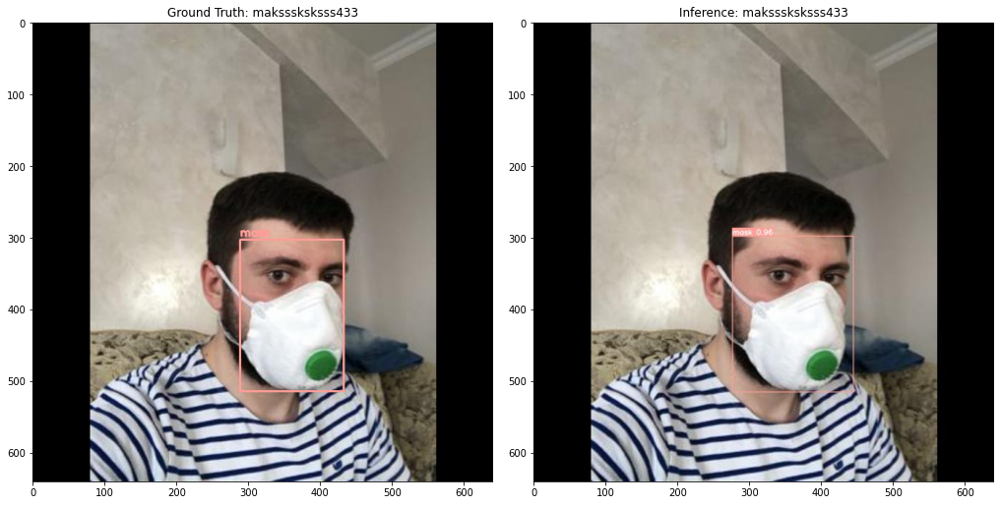

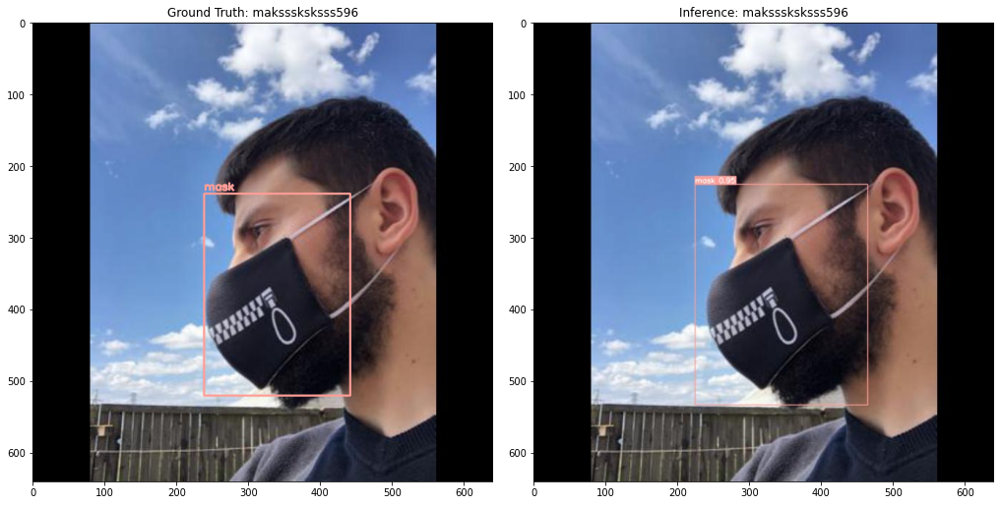

...

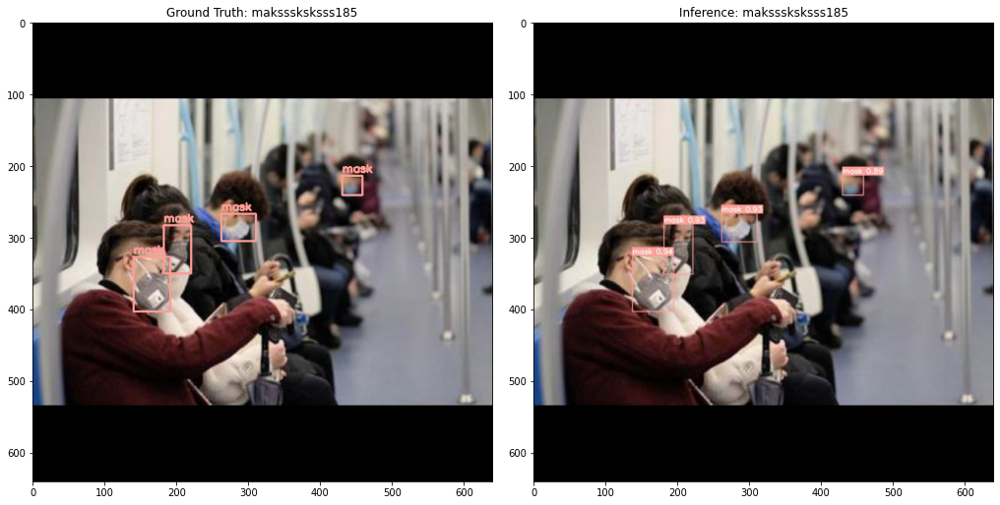

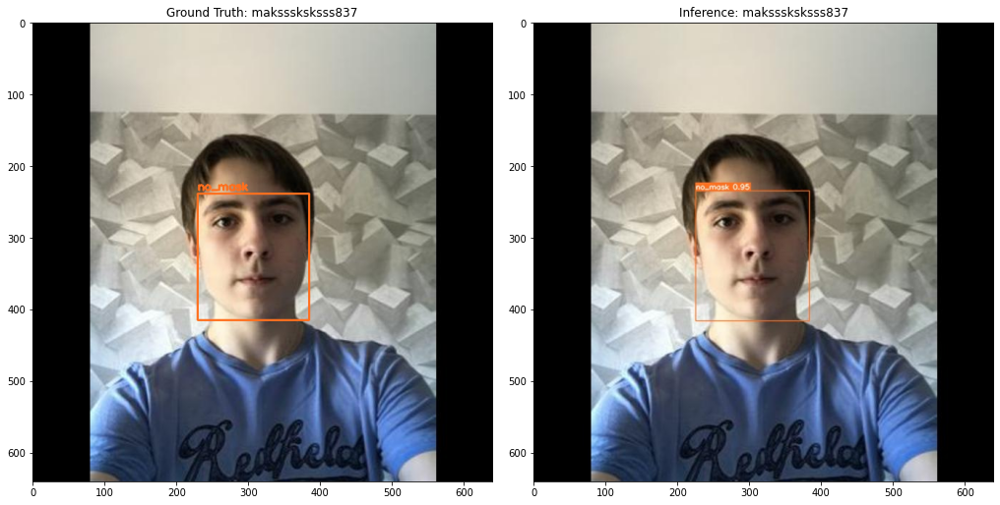

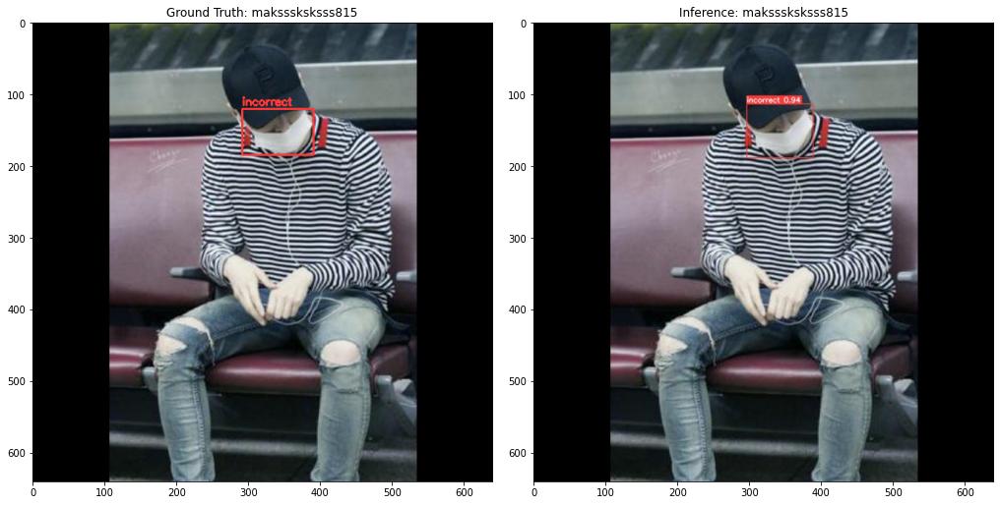

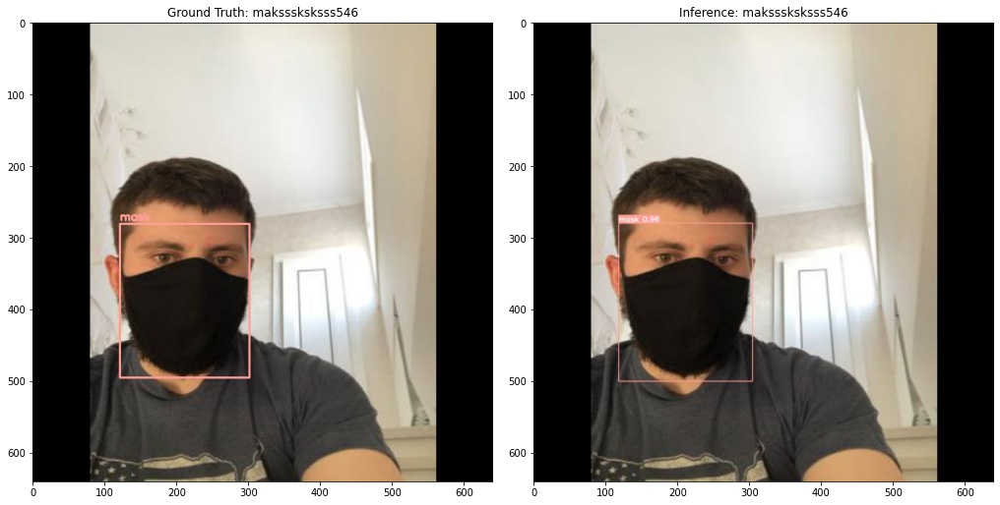

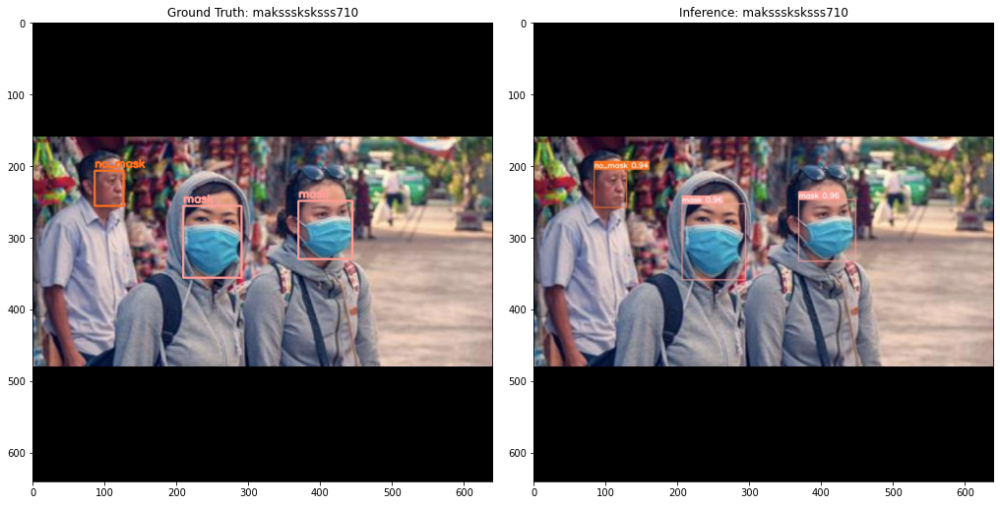

In [ ]:
#plot ground truth and inference side by side
gt_path_lst = [imageName for imageName in glob.glob(dataset.location + "/test/images/*.jpg")]
inference_path_lst = ['runs/detect/exp/'+ i.split("/")[-1] for i in gt_path_lst]

for i in range(len(gt_path_lst)):
    gt_img_arr = cv2.imread(gt_path_lst[i])
    gt_img_arr = cv2.cvtColor(gt_img_arr, cv2.COLOR_BGR2RGB)  # change from BGR to RGB

    img_df = df[df["filename"] == gt_path_lst[i].split("/")[-1]]
    nrow = len(gt_path_lst)
    figsize = (14, 7)
    fig, ax = plt.subplots(
        nrows=1, ncols=2, figsize=figsize, constrained_layout=True
    )
    
    infer_img_arr = cv2.imread(inference_path_lst[i])
    infer_img_arr = cv2.cvtColor(infer_img_arr, cv2.COLOR_BGR2RGB)
    
    for idx, row in img_df.iterrows():
        if row["class"] == 1:
            color = (255, 157, 151)  # green
            text = "mask"
        elif row["class"] == 2:
            color = (255, 112, 31)  # red
            text = "no_mask"
        elif row["class"] == 0:
            color = (255, 56, 56)  # yellow
            text = "incorrect"
        start_point = (int(row["x1"]), int(row["y1"]))
        end_point = (int(row["x2"]), int(row["y2"]))
        cv2.rectangle(
            gt_img_arr, start_point, end_point, color=color, thickness=2
        )
        cv2.putText(
            gt_img_arr,
            org=(int(row["x1"]), int(row["y1"] - 5)),
            text=text,
            fontFace=cv2.FONT_HERSHEY_SIMPLEX,
            fontScale=0.5,
            color=color,
            thickness = 2
        )
        
        ax[0].imshow(gt_img_arr)
        ax[1].imshow(infer_img_arr)
        
        fig_title = re.search(r"maksssksksss\d+",gt_path_lst[i]).group()
        ax[0].set_title(f"Ground Truth: {fig_title}")
        ax[1].set_title(f"Inference: {fig_title}")

### Inference Results Discussion 

- Majority of the inference images are aligned with the ground truth. 
- Interestingly for `masksssksksss633` the original author has wrongly annoated the groud truth and was not detected during the EDA stage. It also interesting to see that the model also failed to detect the mask correctly in this situation. 
- From `masksssksksss342` and `masksssksksss735`, model failed to detect some of the cases. 
- In `masksssksksss179`, the model has correctly predicted additinal 2 people wearing mask on the far right of the picture. However, the original author did not annotate the grouth truth in completness.


## Save Trained Weights

In [ ]:
# save trained weights
from google.colab import files

files.download("./runs/train/exp/weights/best.pt")

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>